In [1]:
%matplotlib inline

In [2]:
import argparse
import json
import random
from math import floor
from pathlib import Path
from typing import Callable
from PIL import Image

import matplotlib.pyplot as plt
import matplotlib as mpl
import numpy as np
import torch
import torch.distributed as dist
from torch.utils.data import IterableDataset
from torch.utils.data.distributed import DistributedSampler
from torchvision import transforms
from torchvision.transforms.functional import crop

from egg.core.interaction import Interaction, LoggingStrategy
from egg.core.batch import Batch
from egg.zoo.referential_language.games import build_game

from IPython.core.debugger import set_trace

mpl.rcParams['figure.dpi']= 100

# Parent Class for a VG Dataset

In [3]:
def pil_loader(path: str) -> Image.Image:
    with open(path, "rb") as f:
        img = Image.open(f)
        return img.convert("RGB")


class VisualGenomeDataset:
    def __init__(
        self,
        image_dir: str,
        metadata_dir: str,
        classes_path: str = "/private/home/rdessi/EGG/egg/zoo/referential_language/utils/classes_1600.txt",
        split: str = "train",
        transform: Callable = transforms.ToTensor(),
        max_objects=10,
        image_size=64,
    ):
        assert max_objects >= 3
        path_images = Path(image_dir)
        path_metadata = Path(metadata_dir) / f"{split}_objects.json"
        path_image_data = Path(metadata_dir) / f"{split}_image_data.json"

        with open(path_image_data) as img_in, open(path_metadata) as metadata_in:
            img_data, img_metadata = json.load(img_in), json.load(metadata_in)
        assert len(img_data) == len(img_metadata)

        self.class2id = {}
        idx = 0
        with open(classes_path) as f:
            for line in f:
                names = line.strip().split(",")
                for name in names:
                    self.class2id[name] = idx
                    idx += 1

        self.samples = []
        for img, objs_data in zip(img_data, img_metadata):
            assert img["image_id"] == objs_data["image_id"]
            img_path = path_images / "/".join(img["url"].split("/")[-2:])

            self.samples.append((img_path, objs_data["objects"]))

        self.id2class = {v: k for k, v in self.class2id.items()}
        self.transform = transform
        self.max_objects = max_objects
        self.resizer = transforms.Resize(size=(image_size, image_size))

    def _extract_object(self, image, obj_data):
        label = None
        for name in obj_data["names"]:
            if name in self.class2id:
                label = self.class2id[name]
                break
        assert label is not None

        y, x, h, w = obj_data["y"], obj_data["x"], obj_data["h"], obj_data["w"]
        obj = self.resizer(crop(image, y, x, h, w))
        return obj, label

    def __len__(self):
        return len(self.samples)

    def _load_and_transform(self, img_path):
        image = pil_loader(img_path)
        if self.transform:
            image = self.transform(image)
        return image

    def _get_aux_input_random_dist(self):
        mask = torch.ones(self.max_objects).bool()
        game_labels = torch.arange(self.max_objects)
        baseline = torch.Tensor([1 / self.max_objects])
        return {"mask": mask, "game_labels": game_labels, "baseline": baseline}

# Datasets for random distractors

In [4]:
class TrainVisualGenomeDatasetRandomDistractors(VisualGenomeDataset):
    def __getitem__(self, index):
        labels, cropped_objs = [], []
        lineup = [self.samples[index]] + sample(self.samples, k=self.max_objects - 1)
        for img_path, bboxes in lineup:
            image = self._load_and_transform(img_path)

            cropped_obj, label = self._extract_object(image, bboxes[0])
            labels.append(label)
            cropped_objs.append(cropped_obj)

        game_input = torch.stack(cropped_objs)
        labels = torch.Tensor(labels)
        aux_input = self._get_aux_input_random_dist()
        aux_input["img_input"] = game_input
        # aux_input["full_image"] = self.resizer(self.curr_img)
        return game_input, labels, torch.zeros(1), aux_input


class TestVisualGenomeDatasetRandomDistractors(VisualGenomeDataset, IterableDataset):
    def __init__(self, *args, **kwargs):
        super(TestVisualGenomeDatasetRandomDistractors, self).__init__(*args, **kwargs)

    def __iter__(self):
        self.curr_idx = 0
        self.curr_obj_idx = 0

        world_size = dist.get_world_size() if dist.is_initialized() else 1
        rank = dist.get_rank() if dist.is_initialized() else 0
        per_gpu = int(floor(len(self.samples) / float(world_size)))

        iter_start = per_gpu * rank
        iter_end = iter_start + per_gpu

        worker_info = torch.utils.data.get_worker_info()
        if worker_info:  # num_workers is > 0
            per_worker = int(floor(per_gpu / worker_info.num_workers))
            iter_start = iter_start + worker_info.id * per_worker
            iter_end = iter_start + per_worker

        self.samples = self.samples[iter_start:iter_end]
        self._load_new_sample()  # load first sample
        return self

    def _load_new_sample(self):
        img_path, obj_data = self.samples[self.curr_idx]
        self.curr_img = self._load_and_transform(img_path)
        self.curr_obj_data = obj_data
        self.max_obj_idx = min(self.max_objects, len(self.curr_obj_data))

    def __next__(self):
        if self.curr_obj_idx >= self.max_obj_idx:
            self.curr_obj_idx = 0
            self.curr_idx += 1
            if self.curr_idx >= len(self.samples):
                raise StopIteration
            self._load_new_sample()

        obj_data = self.curr_obj_data[self.curr_obj_idx]
        obj, label = self._extract_object(self.curr_img, obj_data)
        self.curr_obj_idx += 1

        cropped_objs, labels = [obj], [label]
        distractors = sample(self.samples, k=self.max_objects - 1)
        for img_path, bboxes in distractors:
            image = self._load_and_transform(img_path)

            cropped_obj, label = self._extract_object(image, bboxes[0])
            labels.append(label)
            cropped_objs.append(cropped_obj)

        game_input = torch.stack(cropped_objs)
        labels = torch.Tensor(labels)

        aux_input = self._get_aux_input_random_dist()
        aux_input["img_input"] = game_input
        # aux_input["full_image"] = self.resizer(self.curr_img)
        return game_input, label, torch.zeros(1), aux_input

# Datasets for contextual distractors

In [5]:
class VisualGenomeDatasetCtxDistractors(VisualGenomeDataset, torch.utils.data.Dataset):
    def __init__(self, *args, **kwargs):
        super(VisualGenomeDatasetCtxDistractors, self).__init__(*args, **kwargs)

    def __getitem__(self, index):
        img_path, bboxes = self.samples[index]
        image = self._load_and_transform(img_path)

        cropped_objs, labels = [], []
        for obj in bboxes[: min(self.max_objects, len(bboxes))]:
            cropped_obj, label = self._extract_object(image, obj)
            labels.append(label)
            cropped_objs.append(cropped_obj)

        agent_input = torch.stack(cropped_objs)
        labels = torch.Tensor(labels)
        return agent_input, labels, image


def collate(batch):
    # resizer = transforms.Resize(size=(128, 128))
    inp, lab = [], []
    for x, l, image in batch:
        inp.append(x)
        lab.append(l)

    inp = torch.nn.utils.rnn.pad_sequence(inp, batch_first=True, padding_value=-1)
    lab = torch.nn.utils.rnn.pad_sequence(lab, batch_first=True, padding_value=-1)

    mask = inp[:, :, 0, 0, 0] != -1
    baseline = 1 / mask.int().sum(-1)
    bsz, max_objs = inp.shape[:2]
    game_labels = torch.arange(max_objs).repeat(bsz, 1)

    aux_input = {
        "mask": mask,
        "game_labels": game_labels,
        "baseline": baseline,
        "img_input": inp,
        #"full_image": torch.stack([resizer(image) for _ in range(len(batch))])
    }
    return inp, lab, None, aux_input

In [6]:
def get_dataloader(
    image_dir: str = "/private/home/rdessi/visual_genome",
    metadata_dir: str = "/private/home/rdessi/visual_genome/filtered_splits",
    batch_size: int = 32,
    split: str = "test",
    image_size: int = 128,
    max_objects: int = 10,
    random_distractors: bool = False,
    seed: int = 111,
):
    collate_fn = None

    kwargs = {
        "image_dir": image_dir,
        "metadata_dir": metadata_dir,
        "split": split,
        "max_objects": max_objects,
        "image_size": image_size,
    }
    if random_distractors:
        if split == "test":
            dataset = TestVisualGenomeDatasetRandomDistractors(**kwargs)
        else:
            dataset = TrainVisualGenomeDatasetRandomDistractors(**kwargs)

    else:
        collate_fn = collate
        dataset = VisualGenomeDatasetCtxDistractors(**kwargs)

    is_iterable_dataset = random_distractors and split == "test"
    sampler = None
    if dist.is_initialized():
        if not is_iterable_dataset:
            shuffle = split != "test"
            sampler = DistributedSampler(
                dataset, shuffle=shuffle, drop_last=True, seed=seed
            )
    return torch.utils.data.DataLoader(
        dataset,
        batch_size=batch_size,
        num_workers=6,
        sampler=sampler,
        collate_fn=collate_fn,
        shuffle=(not is_iterable_dataset and sampler is None and split != "test"),
        pin_memory=True,
        drop_last=True,
    )

In [7]:
random_distractors = False
dloader = get_dataloader(random_distractors = random_distractors)

In [8]:
checkpoint_path = "/private/home/rdessi/contextual_emcomm/ctx/self_attn/53233351_0/final.tar"

# checkpoint_path = "/private/home/rdessi/contextual_emcomm/baseline/53233364_3/final.tar"

opts = {
    "batch_size": 128,
    "split": "test",
    "vision_model": "resnet34",
    "pretrain_vision": True,
    "random_seed": 111,
    "loss_temperature": 0.1,
    "gs_temperature": 0.5,
    "random_msg_position": False,
    "distributed_context": argparse.Namespace(is_distributed=False),
    "max_objects": 10,
    "random_distractors": random_distractors,
    #
    "output_dim": 256,
    "vocab_size": 2000,
    "attn_type": "self",
    "attn_topk": 1,
    "num_heads": 1,
    "single_symbol": False,
    "random_k": False, 
    "recv_separate_embeddings": True, 
    "sender_separate_mlps": False,
}

opts = argparse.Namespace(**opts)

In [9]:
checkpoint = torch.load(checkpoint_path)
game = build_game(opts)

game.load_state_dict(checkpoint.model_state_dict)

<All keys matched successfully>

In [10]:
logging_test_args = [False, True, True, True, True, True, False] 
test_logging_strategy = LoggingStrategy(*logging_test_args)
game.game.test_logging_strategy = test_logging_strategy

In [23]:
def eval(game, data):
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

    game.eval()
    game.to(device)
    interactions = []
    with torch.no_grad():
        for batch_id, batch in enumerate(data):
            if not isinstance(batch, Batch):
                batch = Batch(*batch)
            batch = batch.to(device)
           
            _, interaction = game(*batch)
            interactions.append(interaction.to("cpu"))

    full_interaction = Interaction.from_iterable(interactions)
    return full_interaction

In [24]:
interaction = eval(game, dloader)

In [25]:
receiver_output = torch.argmax(
    interaction.receiver_output.view(-1, opts.batch_size, opts.max_objects, opts.max_objects),
    dim=-1,
)

bla = 0
err = 0
pairs = []
for batch_id, batch in enumerate(interaction.aux_input["all_accs"][:20]):
    for elem_id, batch_elem in enumerate(batch):
        for guess_id, guess_acc in enumerate(batch_elem):
            if guess_acc.item() == 0. and interaction.aux_input["mask"][batch_id, elem_id, guess_id] == 1:
                if opts.random_distractors and guess_id != 0:
                    continue
                err += 1
                correct_guess = guess_id
                recv_guess = receiver_output[batch_id, elem_id, guess_id]
                # assert correct_guess != recv_guess.item()
                if correct_guess == recv_guess.item():
                    bla += 1
                    continue
                
                correct_img = interaction.aux_input["img_input"][batch_id, elem_id, correct_guess].permute(1, 2, 0)
                guessed_img = interaction.aux_input["img_input"][batch_id, elem_id, recv_guess].permute(1, 2, 0)
                # full_image = interaction.aux_input["full_image"][batch_id, elem_id].permute(1, 2, 0)

                pair = torch.cat([correct_img, guessed_img], dim=1)
                pairs.append(pair)
                
print(bla)

738


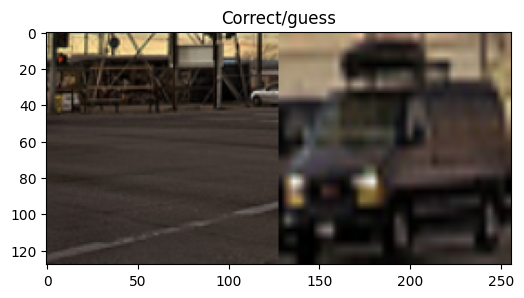

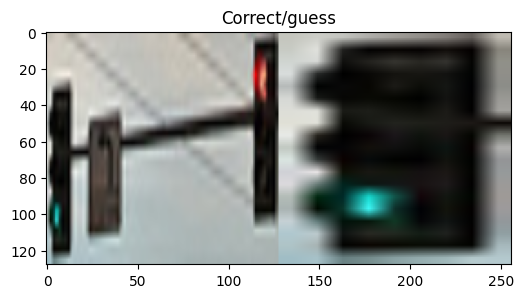

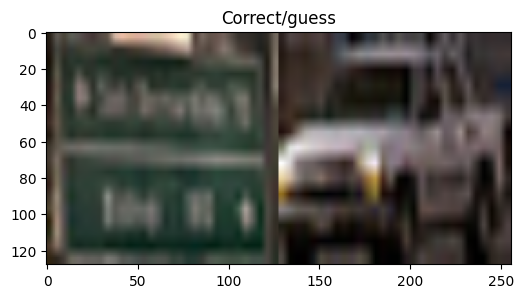

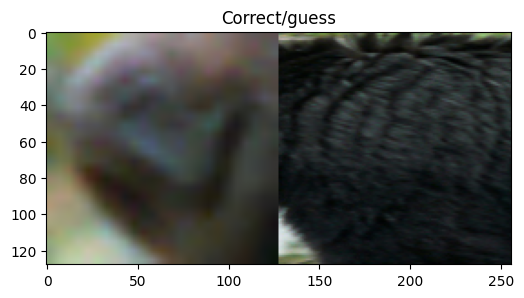

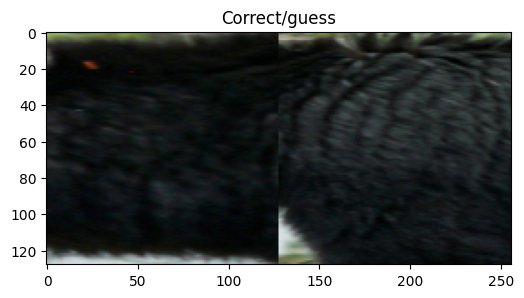

...

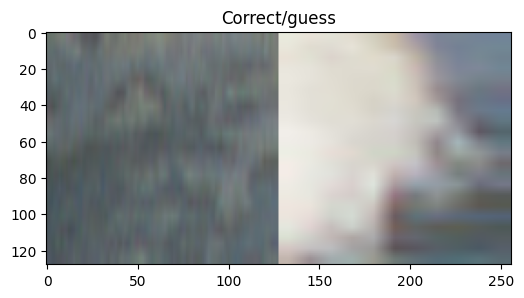

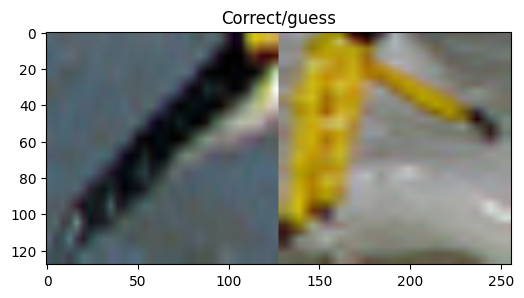

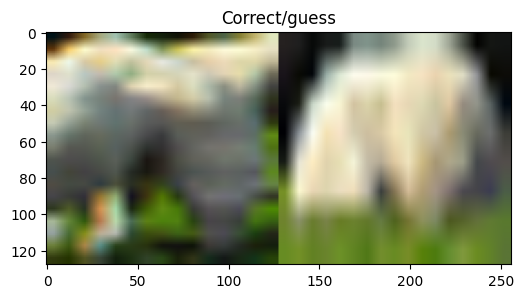

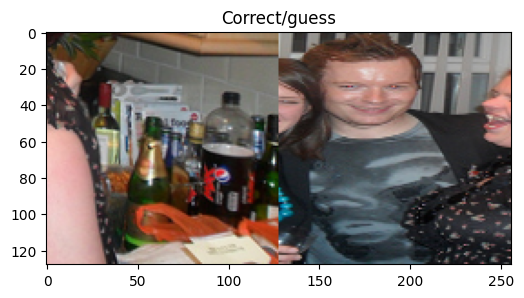

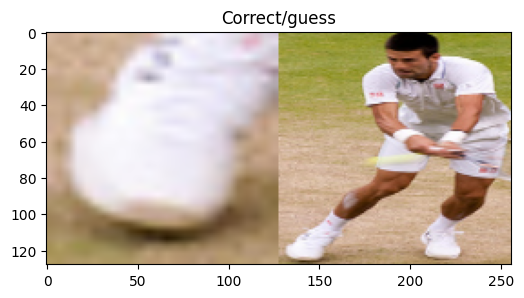

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


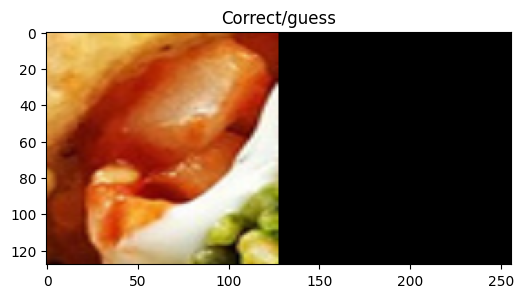

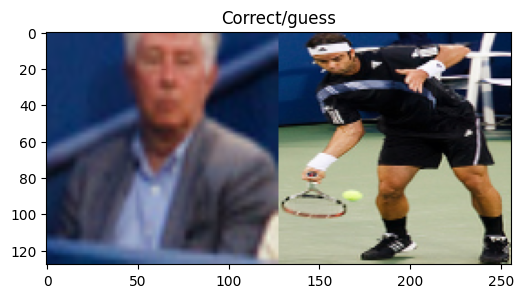

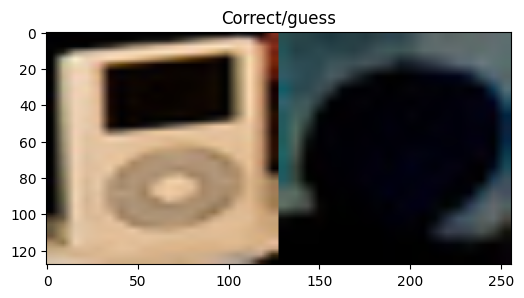

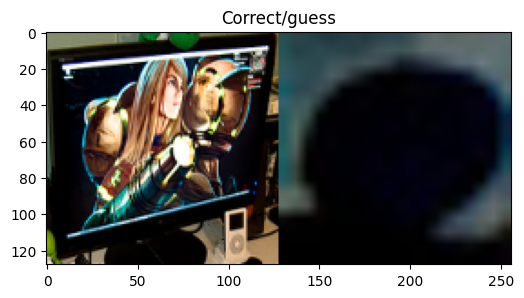

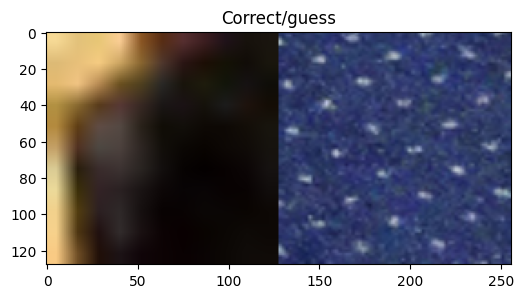

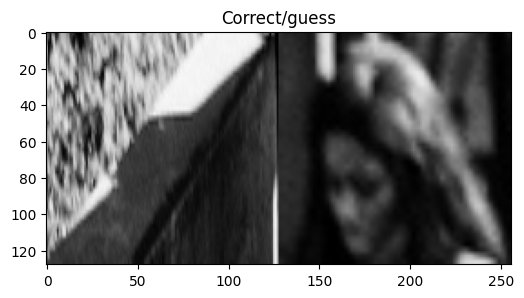

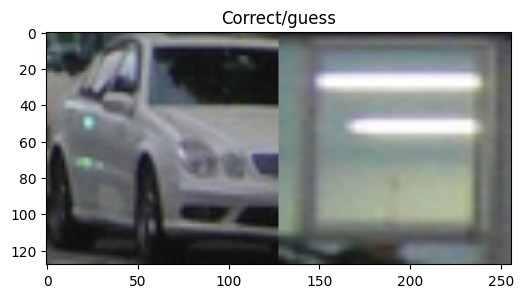

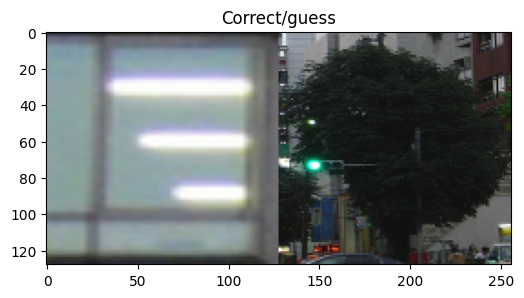

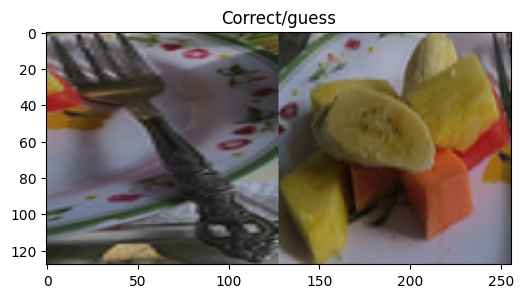

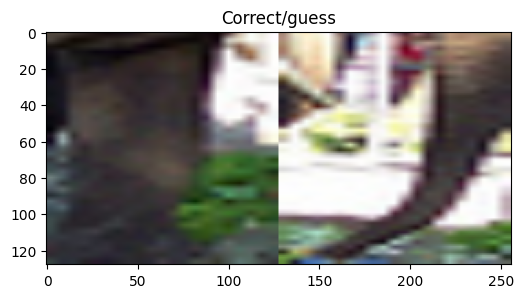

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


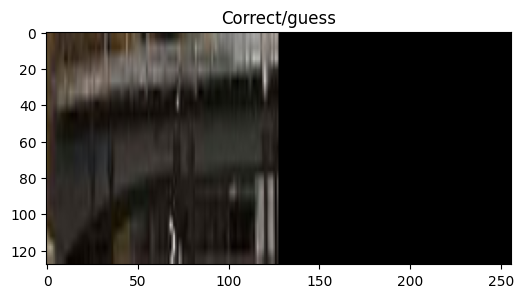

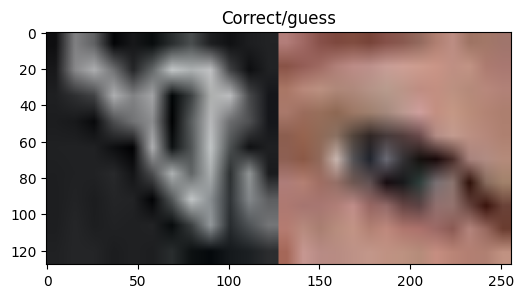

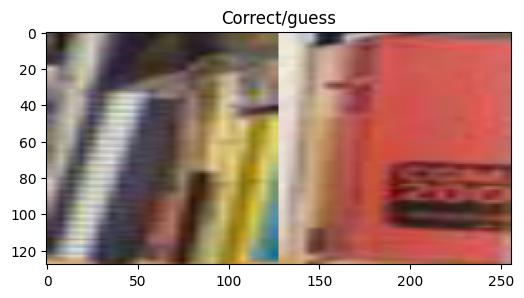

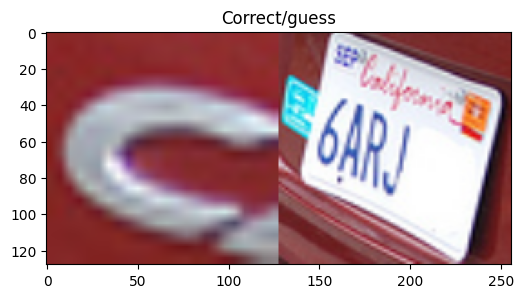

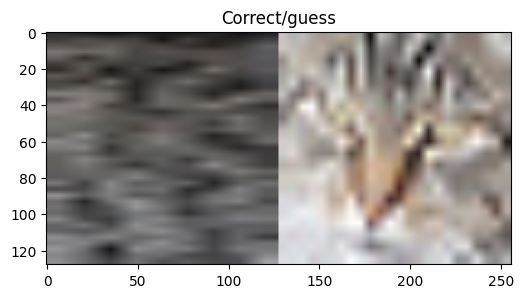

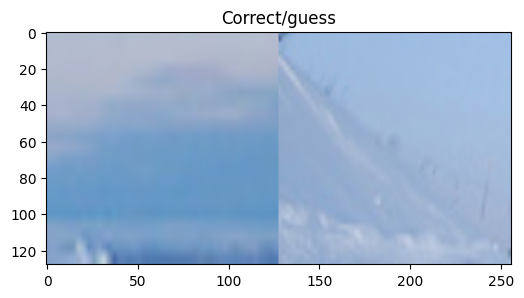

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


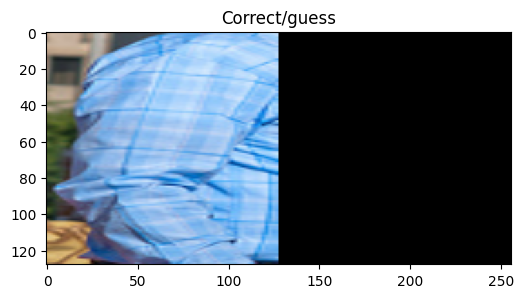

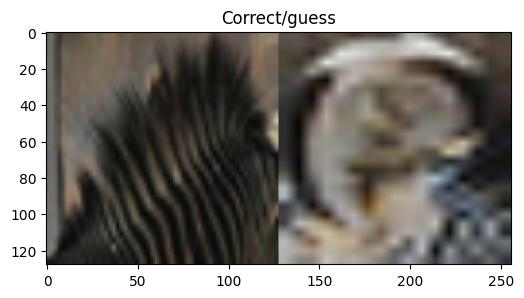

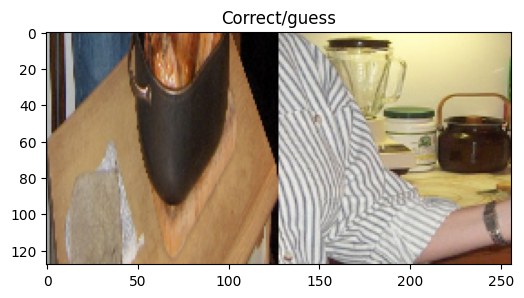

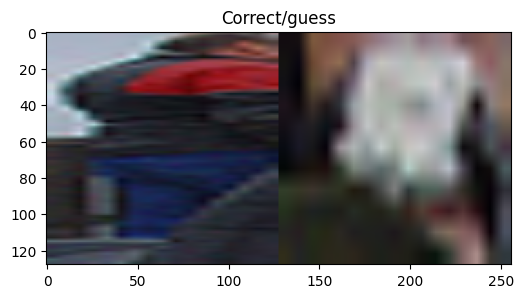

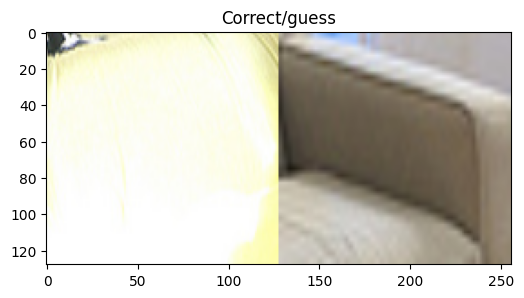

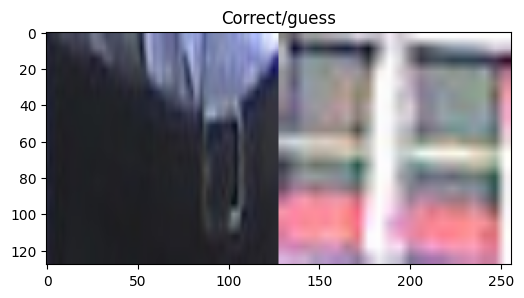

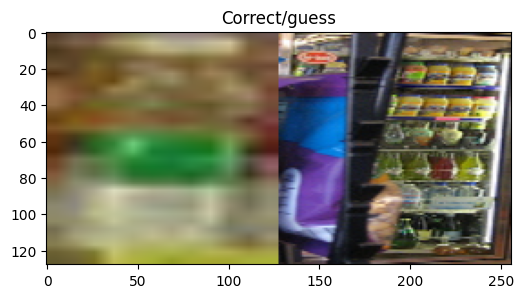

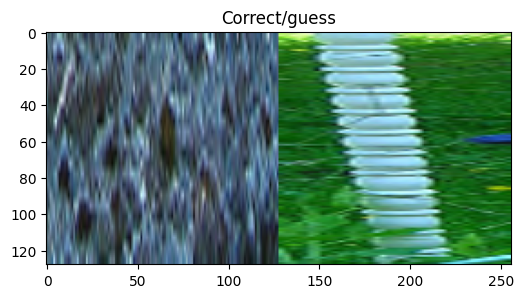

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


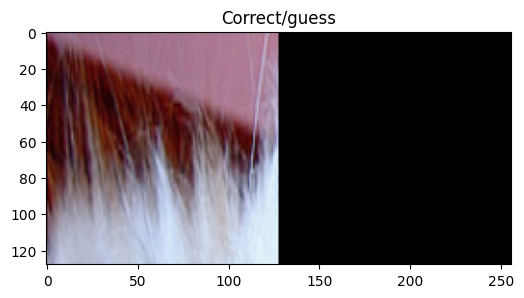

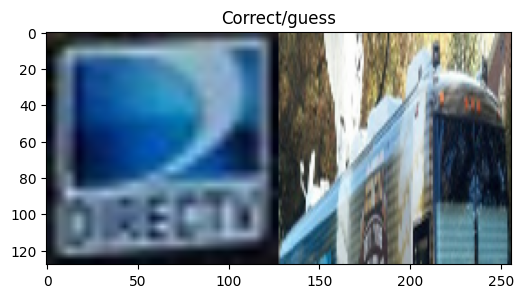

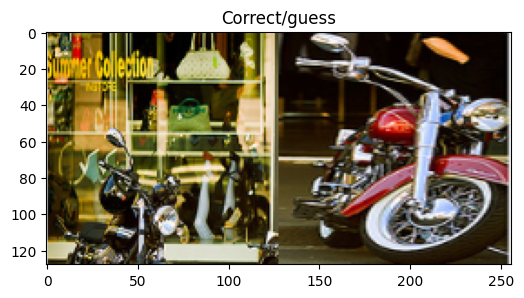

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


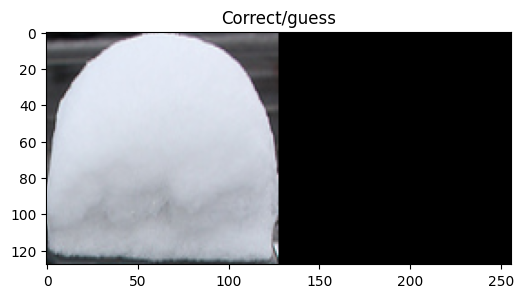

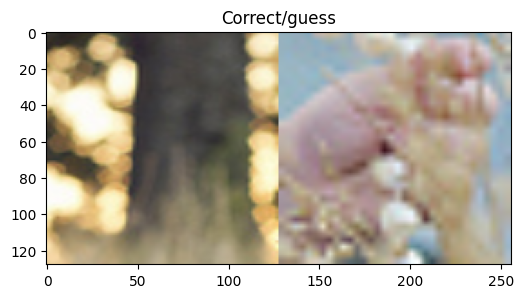

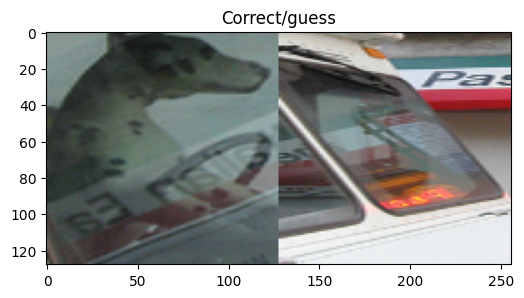

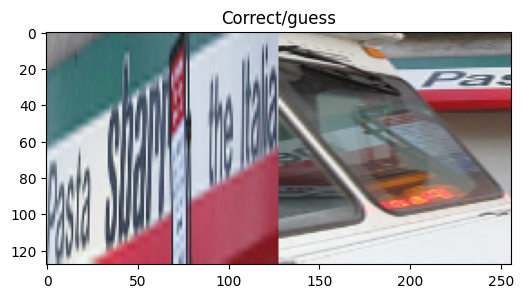

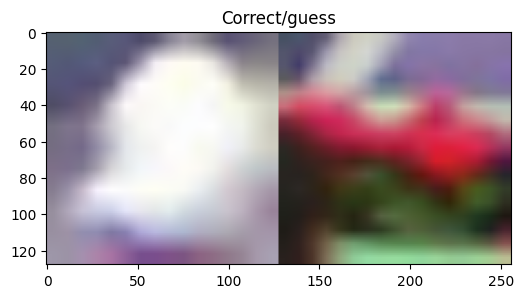

...

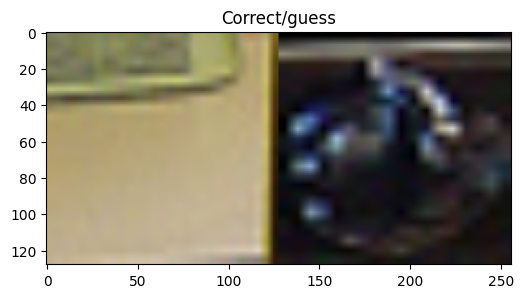

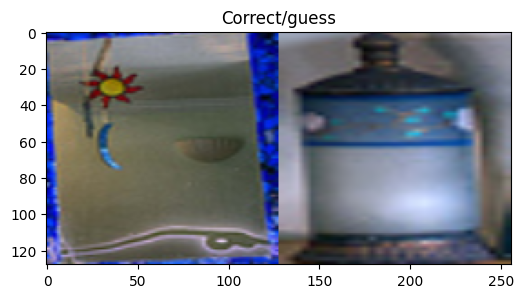

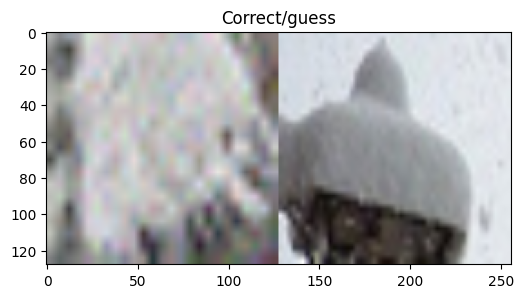

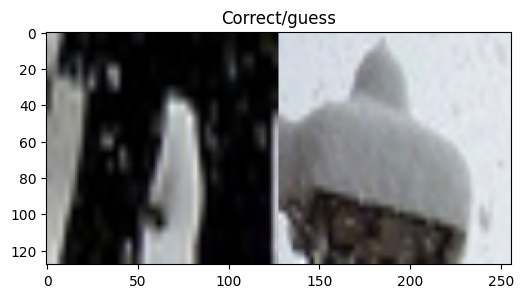

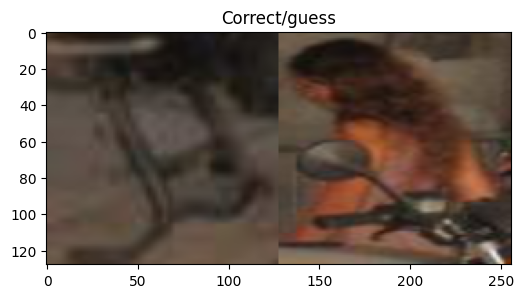

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


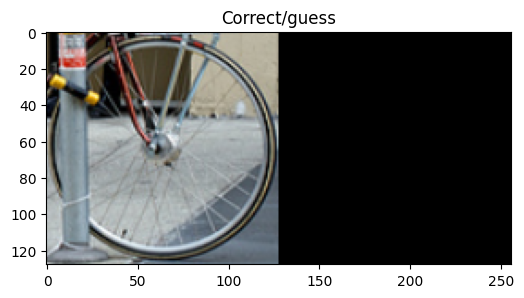

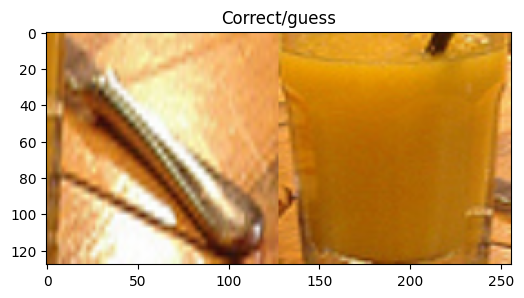

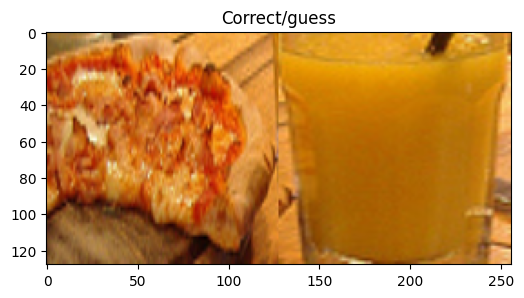

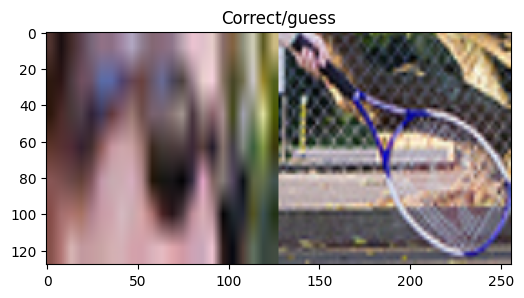

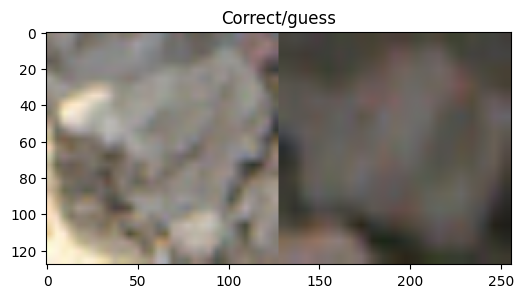

...

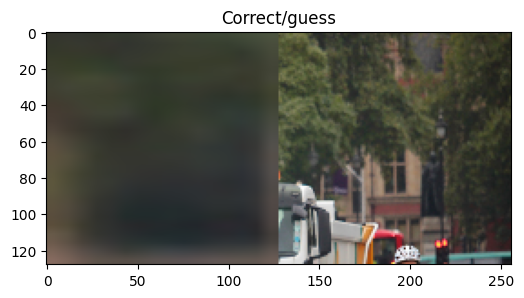

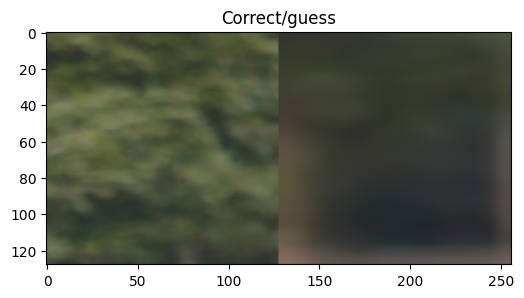

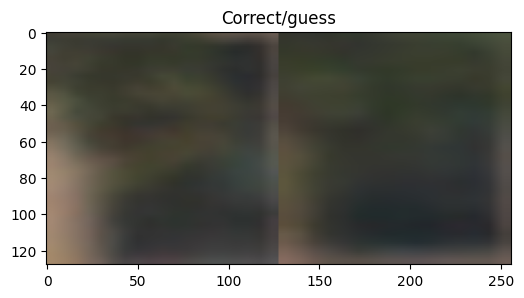

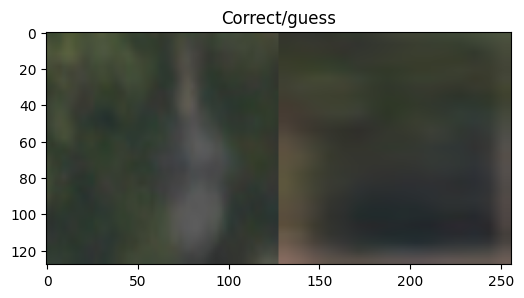

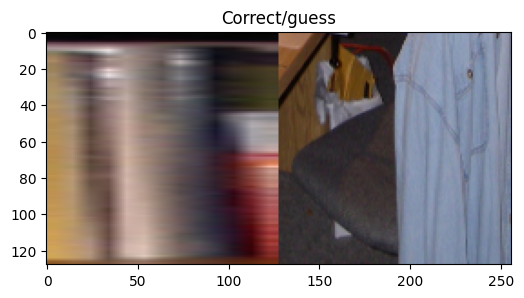

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


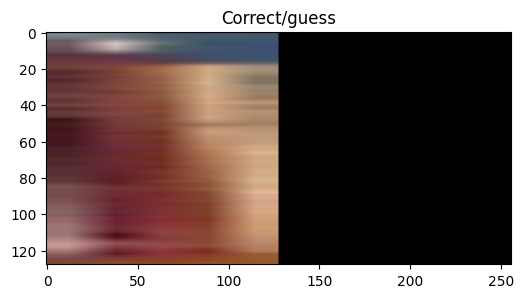

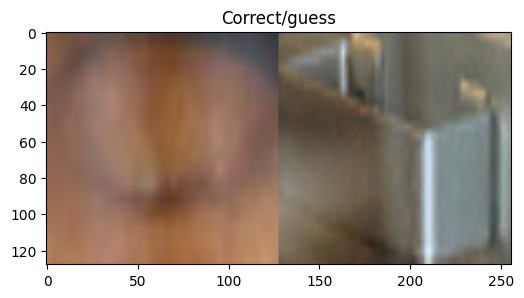

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


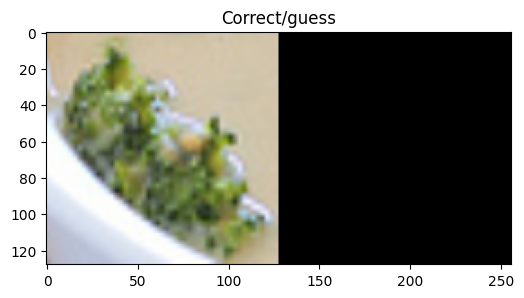

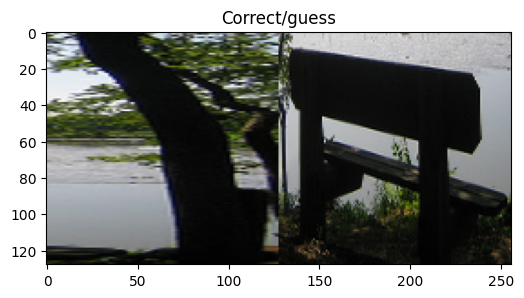

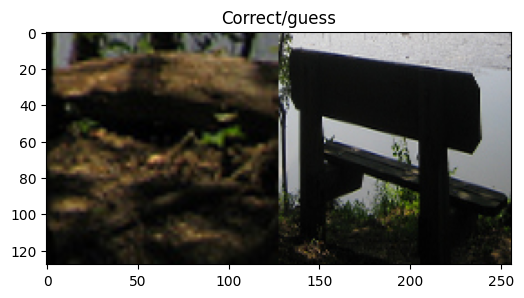

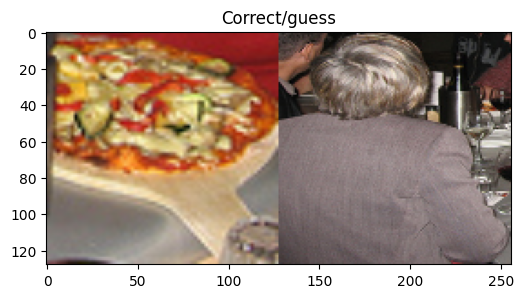

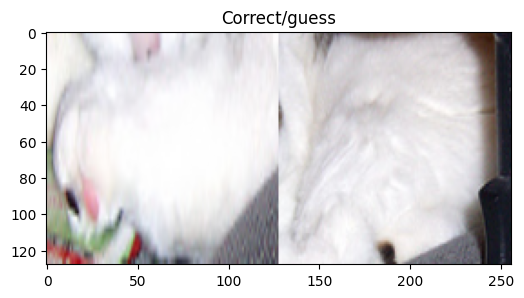

...

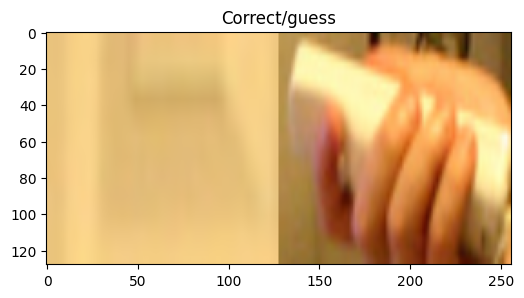

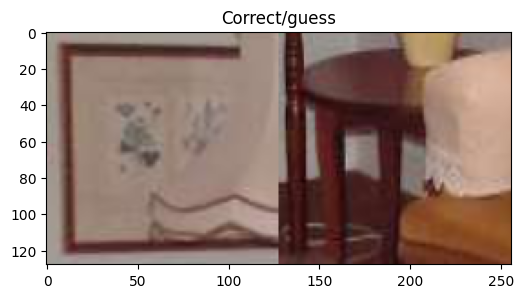

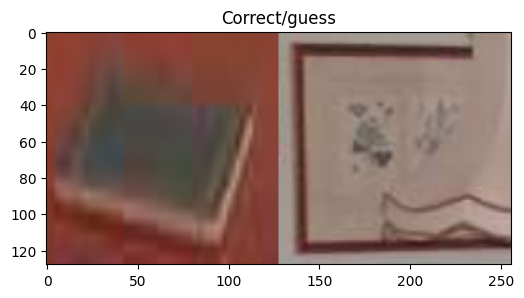

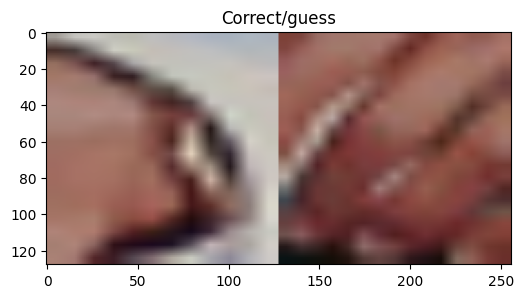

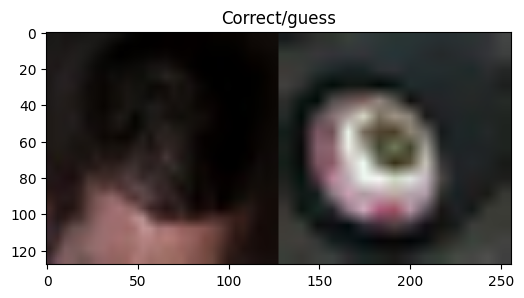

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


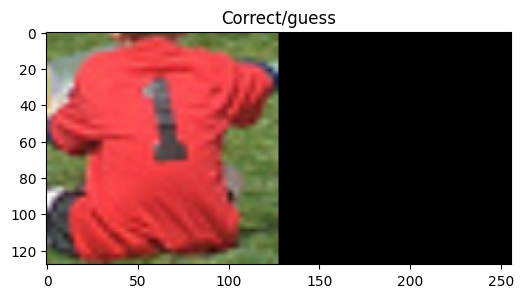

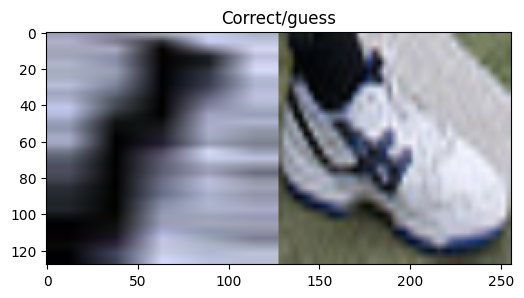

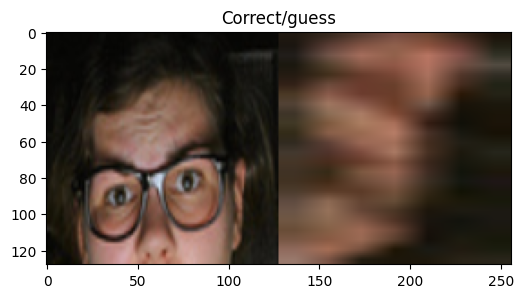

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


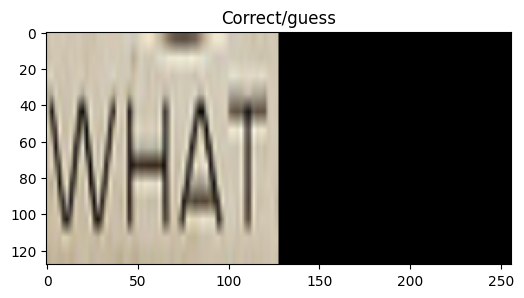

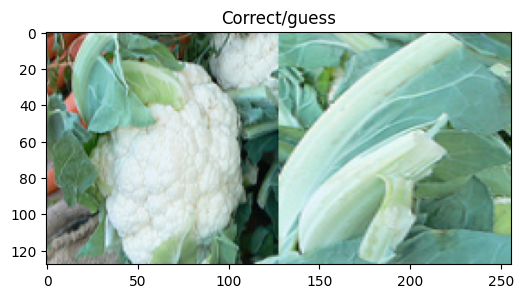

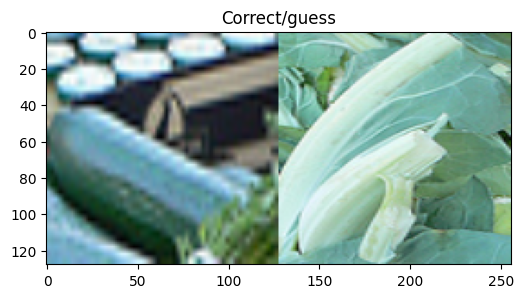

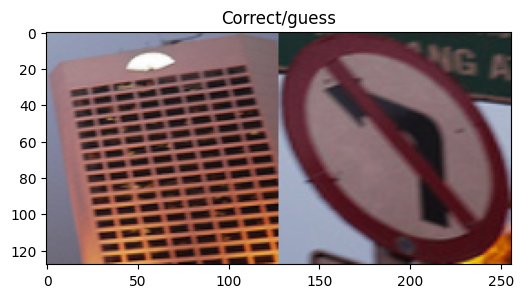

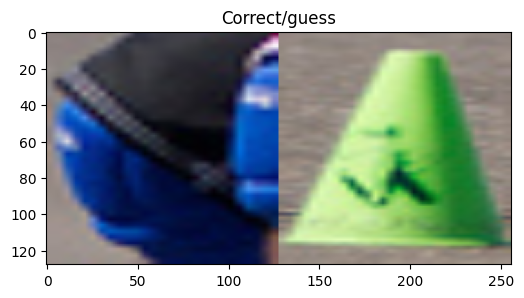

...

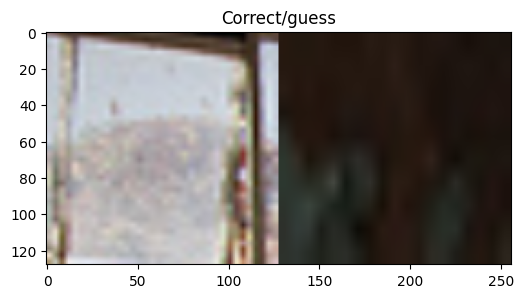

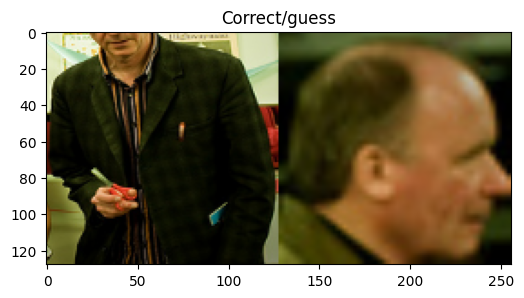

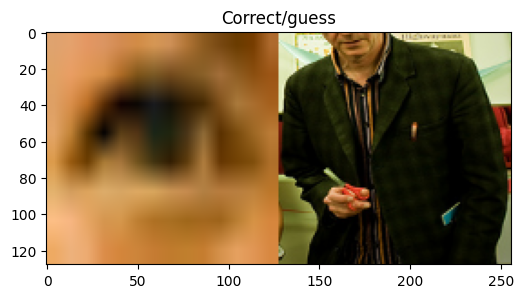

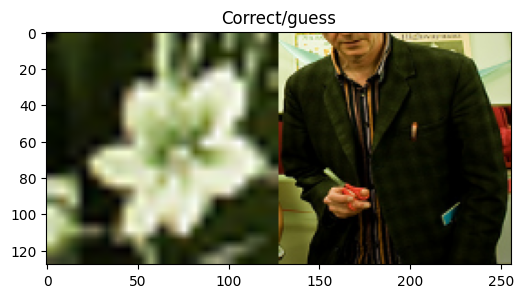

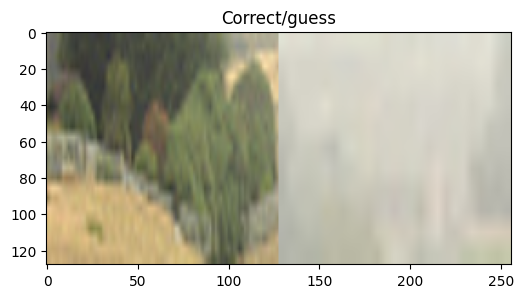

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


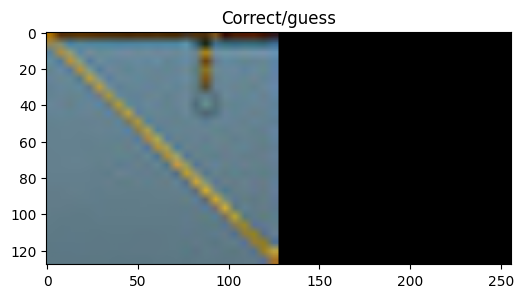

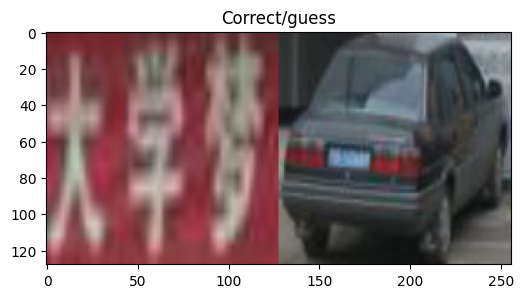

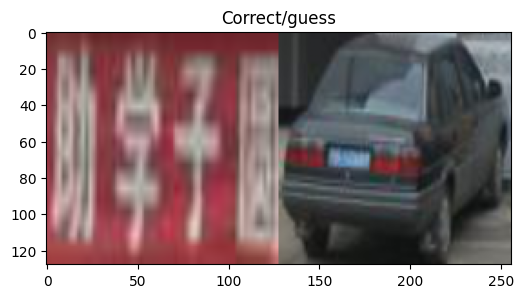

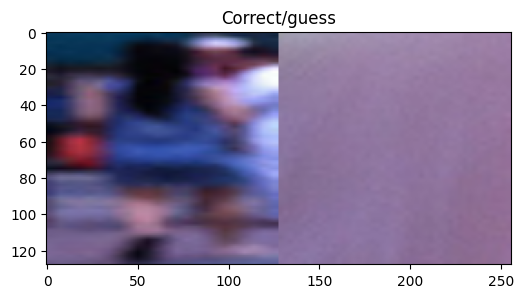

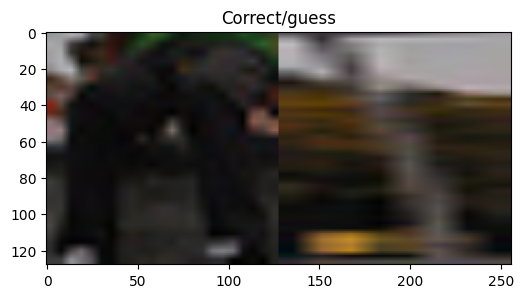

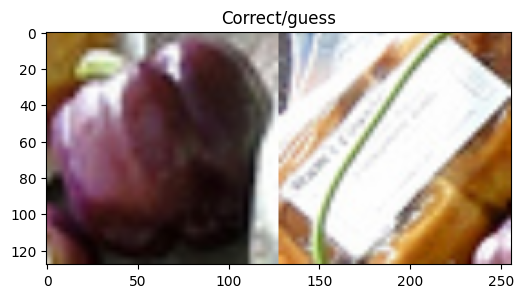

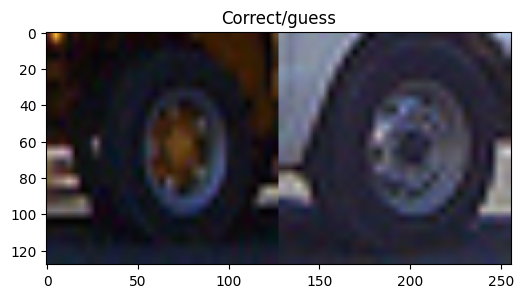

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


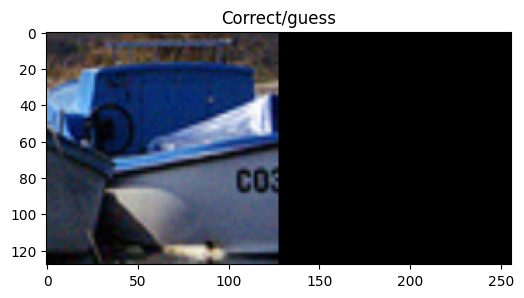

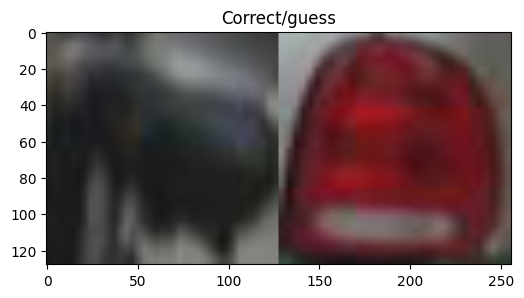

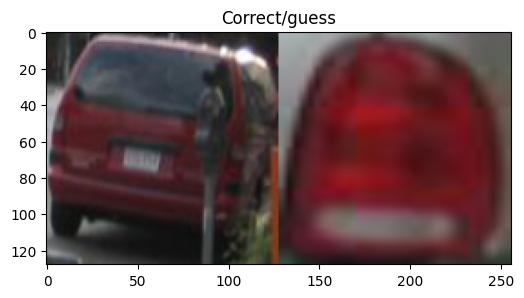

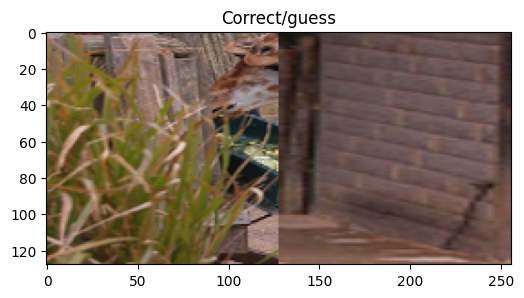

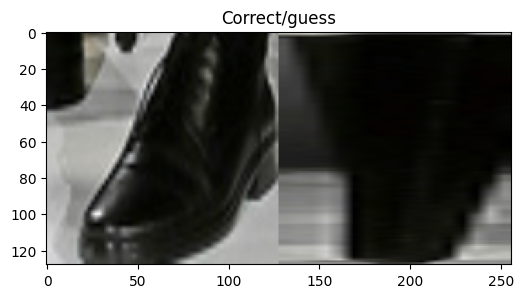

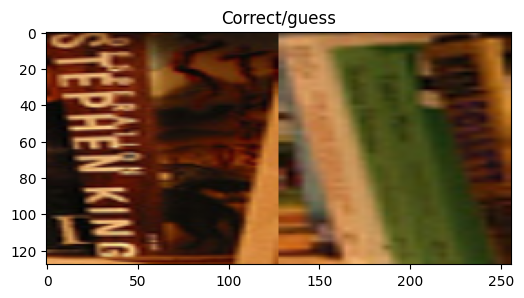

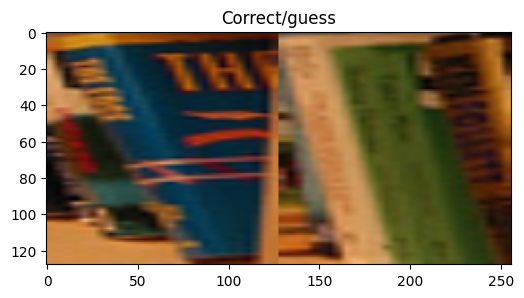

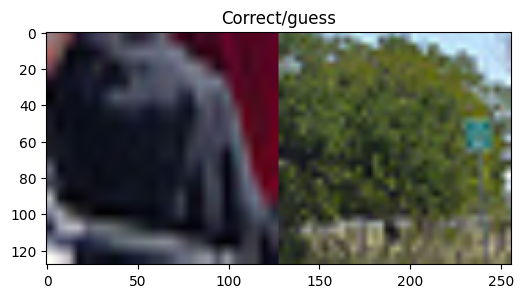

In [ ]:
for pair in pairs:
    plt.title("Correct/guess")
    plt.imshow(pair.numpy())
    plt.show()
    